In [2]:
from google.colab import drive
drive.mount('/content/drive',force_remount=True)

Mounted at /content/drive


In [3]:
from IPython.display import clear_output as cls
!pip install tf_explain
cls()

In [4]:
# Common
import os
import keras
import numpy as np
from glob import glob
from tqdm import tqdm
import tensorflow as tf

# Data
import tensorflow.data as tfd
import tensorflow.image as tfi
from tensorflow.keras.utils import load_img, img_to_array

# Data Visualization
import matplotlib.pyplot as plt

# Model
from keras.layers import ReLU
from keras.layers import Input
from keras.layers import Layer
from keras.layers import Conv2D
from keras.layers import Concatenate
from keras.layers import UpSampling2D
from keras.layers import AveragePooling2D
from keras.models import Sequential, Model
from keras.layers import BatchNormalization

# Pretrained Model
from tensorflow.keras.applications import ResNet50

# Callbacks
from keras.callbacks import Callback, ModelCheckpoint

# Model Visualization
from tensorflow.keras.utils import plot_model

# Model Explaination
from tf_explain.core.grad_cam import GradCAM
from tf_explain.core.smoothgrad import SmoothGrad

In [5]:
resolver = tf.distribute.cluster_resolver.TPUClusterResolver(tpu='local')
tf.config.experimental_connect_to_cluster(resolver)
# This is the TPU initialization code that has to be at the beginning.
tf.tpu.experimental.initialize_tpu_system(resolver)
print("All devices: ", tf.config.list_logical_devices('TPU'))

All devices:  [LogicalDevice(name='/device:TPU:0', device_type='TPU'), LogicalDevice(name='/device:TPU:1', device_type='TPU'), LogicalDevice(name='/device:TPU:2', device_type='TPU'), LogicalDevice(name='/device:TPU:3', device_type='TPU'), LogicalDevice(name='/device:TPU:4', device_type='TPU'), LogicalDevice(name='/device:TPU:5', device_type='TPU'), LogicalDevice(name='/device:TPU:6', device_type='TPU'), LogicalDevice(name='/device:TPU:7', device_type='TPU')]


In [6]:
strategy = tf.distribute.TPUStrategy(resolver)


In [7]:
files = os.listdir('/content/drive/MyDrive/IISC/XAIproj1/VOCdevkit/VOC2007/SegmentationObject')

In [8]:
maskfiles=[]
maskfiles = list(files)

In [9]:
jpgfile = [x.replace('.png', '.jpg') for x in files]

In [10]:
len(jpgfile)

422

In [11]:
jpgfiletrain=jpgfile[0:350]
jpgfileval=jpgfile[351:421]
maskfiletrain=maskfiles[0:350]
maskfileval=maskfiles[351:421]

In [12]:
image_path = '/content/drive/MyDrive/IISC/XAIproj1/VOCdevkit/VOC2007/JPEGImages/'
mask_path = '/content/drive/MyDrive/IISC/XAIproj1/VOCdevkit/VOC2007/SegmentationObject/'
image_paths = []
mask_paths=[]

In [13]:
def load_image(path, IMAGE_SIZE=256):

    # Load Image
    image = load_img(path)

    # Convert to Array
    image = img_to_array(image)

    # Resize
    image = tfi.resize(image, (IMAGE_SIZE, IMAGE_SIZE))

    # Convert to float32
    image = tf.cast(image, tf.float32)

    # Standardization
    image = image/255.

    return image

def load_images(paths, IMAGE_SIZE=256):

    # Create Space
    images = np.zeros(shape=(len(paths), IMAGE_SIZE, IMAGE_SIZE, 3))

    # Iterate Paths
    for i, path in tqdm(enumerate(paths), desc="Loading"):

        # Load Image
        images[i] = load_image(path, IMAGE_SIZE=IMAGE_SIZE)

    return images

def load_data(root_path, trim=None, IMAGE_SIZE=256, BATCH_SIZE=8, files=False):

    # Collect Image Paths
    #image_paths = glob(root_path + "*.jpg")
    image_paths = [image_path+x for x in root_path]


    # Trim if needed
    if trim is not None:
        image_paths = image_paths[trim[0]:trim[1]]

    # Update mask paths
    maskf=[x.replace('.jpg', '.png') for x in root_path]
    mask_paths  = [mask_path+x for x in maskf]
    #for path in image_paths:
        #mask_path = path.replace("Images", "Masks")
        #mask_paths.append(mask_path)

    # Load Data
    images, masks = load_images(image_paths, IMAGE_SIZE=IMAGE_SIZE), load_images(mask_paths, IMAGE_SIZE=IMAGE_SIZE)

    # Convert To data
    data = tfd.Dataset.from_tensor_slices((images, masks))
    data = data.batch(BATCH_SIZE, drop_remainder=True)
    data = data.shuffle(1000).prefetch(tfd.AUTOTUNE)
    if files:
        return data, images, masks
    return data

In [14]:
image_path

'/content/drive/MyDrive/IISC/XAIproj1/VOCdevkit/VOC2007/JPEGImages/'

In [15]:
train_ds = load_data(jpgfiletrain, IMAGE_SIZE=128)

Loading: 350it [01:31,  3.81it/s]
Loading: 350it [00:04, 75.48it/s] 


In [16]:
valid_ds, val_images, val_masks = load_data(jpgfileval, files=True, IMAGE_SIZE=128)

Loading: 70it [00:16,  4.20it/s]
Loading: 70it [00:00, 197.79it/s]


In [17]:
def show_images(data, model=None, explain=False, n_images=6, SIZE=(25,10)):

    # Plot Configurations
    if model is not None:
        if explain:
            n_cols = 5
        else:
            n_cols = 4
    else:
        n_cols = 3

    # Iterate through data
    for plot_no in range(1, n_images+1):
        for index, (images, masks) in enumerate(iter(data)):

            # Select Items
            id = np.random.randint(len(images))
            image, mask = images[id], masks[id]

            if model is not None:

                if explain:
                    id = np.random.randint(len(val_images))
                    # Make Prediction
                    pred_mask = model.predict(val_images[id][np.newaxis, ...])[0]

                    # Grad CAM
                    cam = GradCAM()
                    cam = cam.explain(
                        validation_data=(val_images[id][np.newaxis,...], val_masks[id]),
                        model=model,
                        class_index=1,
                        layer_name="Top-ConvBlock-2",
                        image_weight=0.5
                    )


                    # Figure
                    plt.figure(figsize=SIZE)

                    # Original Image
                    plt.subplot(1, n_cols, 1)
                    plt.imshow(val_images[id])
                    plt.axis('off')
                    plt.title("Original Image")

                    # Original Mask
                    plt.subplot(1, n_cols, 2)
                    plt.imshow(val_masks[id])
                    plt.axis('off')
                    plt.title('Original Mask')

                    # Predicted Mask
                    plt.subplot(1, n_cols, 3)
                    plt.imshow(pred_mask)
                    plt.axis('off')
                    plt.title("Predicted Mask")

                    # Mixed
                    plt.subplot(1, n_cols, 4)
                    plt.imshow(val_images[id])
                    plt.imshow(pred_mask, alpha=0.4)
                    plt.axis('off')
                    plt.title("Overlaped Prediction")

                    # Mixed
                    plt.subplot(1, n_cols, 5)
                    plt.imshow(cam)
                    plt.axis('off')
                    plt.title("Grad CAM")

                    # Show Image
                    plt.show()

                else:
                    # Make Prediction
                    pred_mask = model.predict(image[np.newaxis, ...])[0]

                    # Figure
                    plt.figure(figsize=SIZE)

                    # Original Image
                    plt.subplot(1, n_cols, 1)
                    plt.imshow(image)
                    plt.axis('off')
                    plt.title("Original Image")

                    # Original Mask
                    plt.subplot(1, n_cols, 2)
                    plt.imshow(mask)
                    plt.axis('off')
                    plt.title('Original Mask')

                    # Predicted Mask
                    plt.subplot(1, n_cols, 3)
                    plt.imshow(pred_mask)
                    plt.axis('off')
                    plt.title("Predicted Mask")

                    # Mixed
                    plt.subplot(1, n_cols, 4)
                    plt.imshow(image)
                    plt.imshow(pred_mask, alpha=0.4)
                    plt.axis('off')
                    plt.title("Overlaped Prediction")

                    # Show Image
                    plt.show()

            else:

                # Figure
                plt.figure(figsize=SIZE)

                # Original Image
                plt.subplot(1, n_cols, 1)
                plt.imshow(image)
                plt.axis('off')
                plt.title("Original Image")

                # Original Mask
                plt.subplot(1, n_cols, 2)
                plt.imshow(mask)
                plt.axis('off')
                plt.title('Original Mask')

                # Mixed
                plt.subplot(1, n_cols, 3)
                plt.imshow(image)
                plt.imshow(mask, alpha=0.4)
                plt.axis('off')
                plt.title("Overlaped Image")

                # Show Image
                plt.show()

            # Break Loop
            break

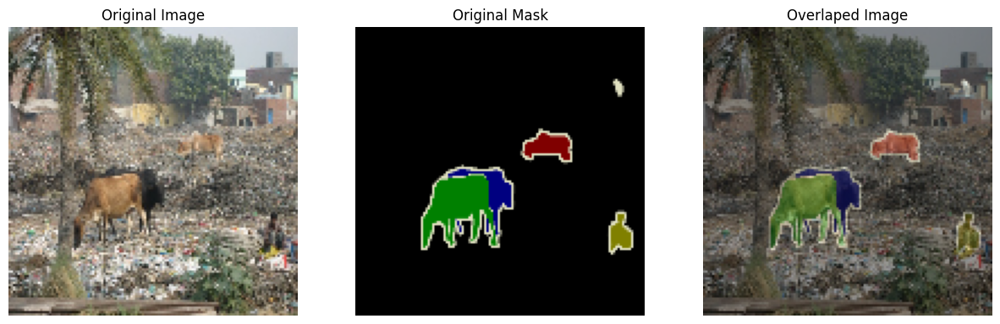

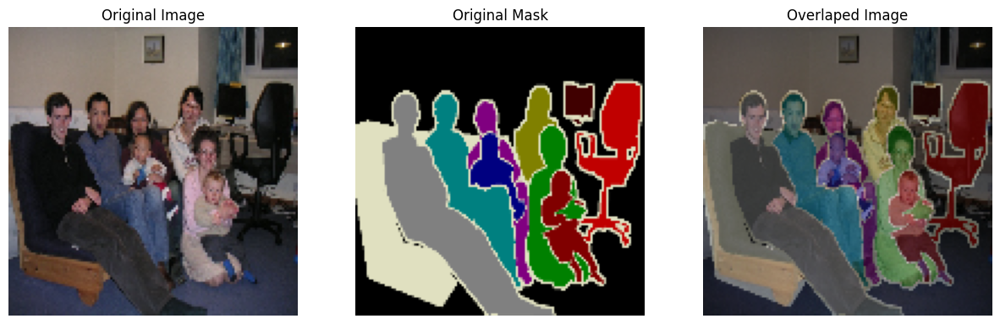

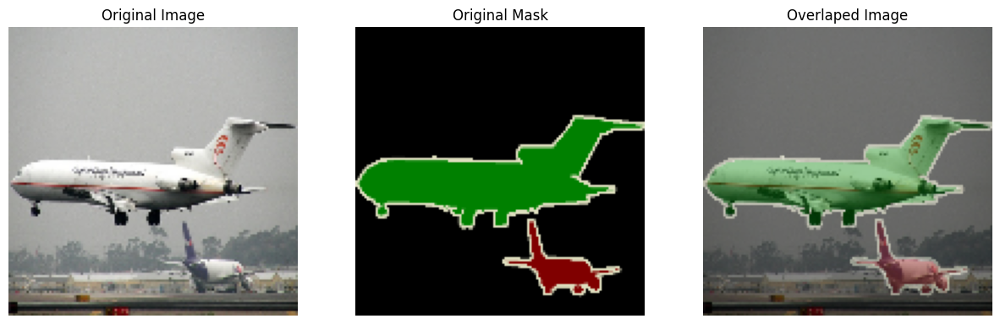

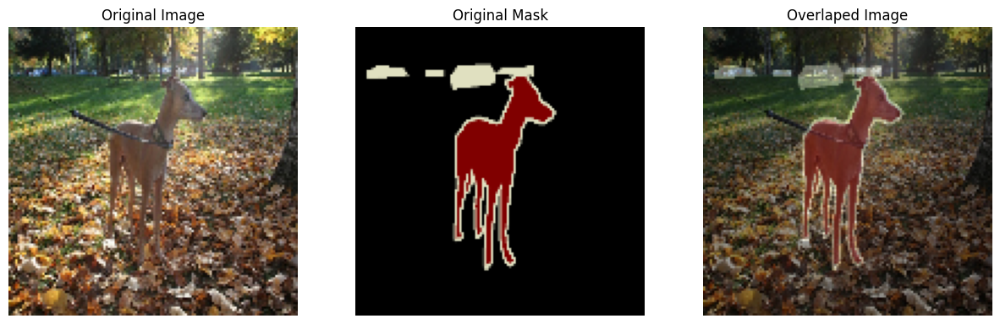

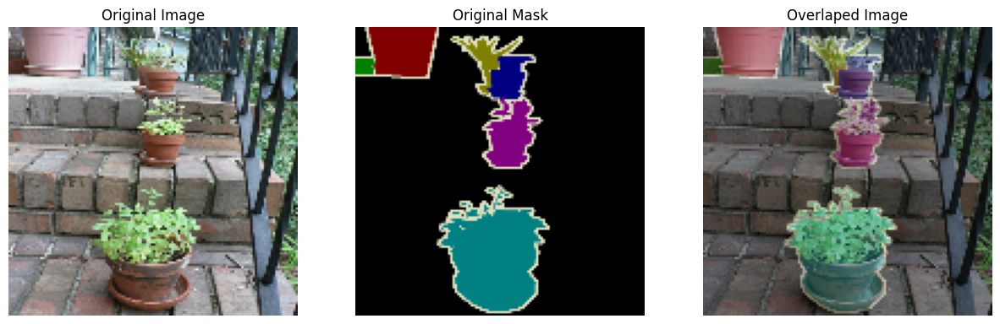

In [18]:
show_images(data=train_ds, n_images=5, SIZE=(15,5))


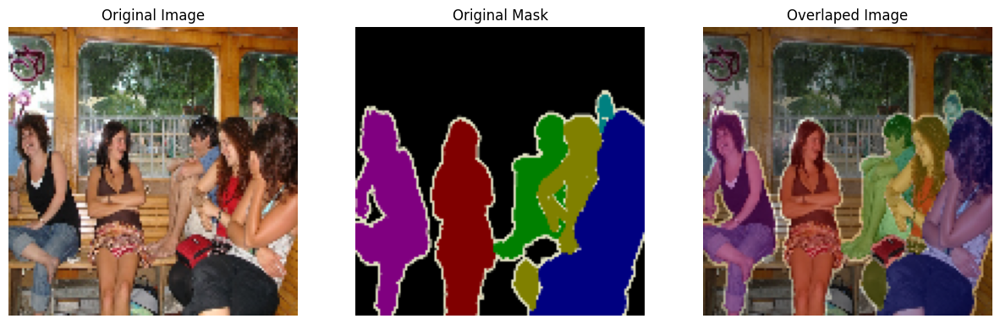

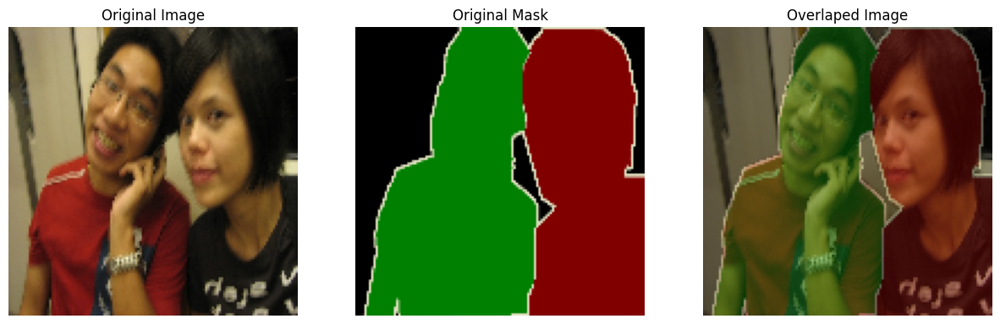

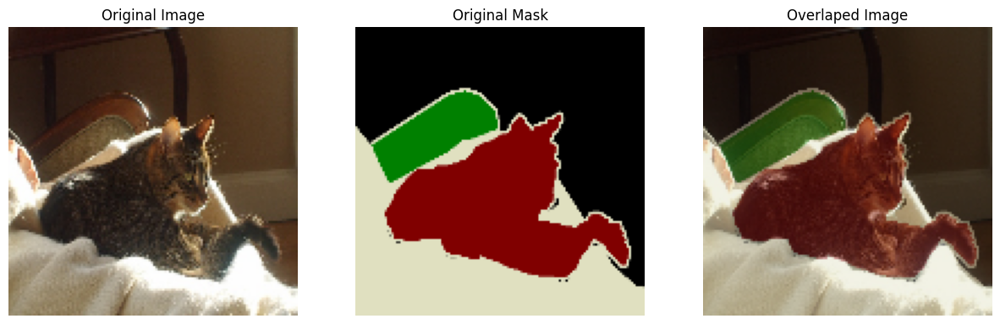

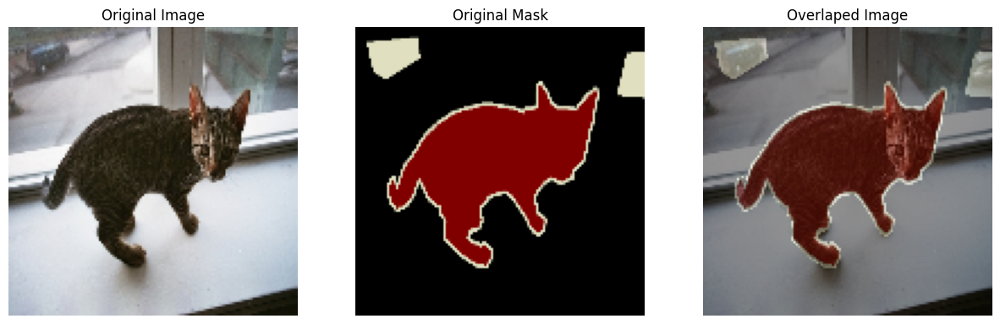

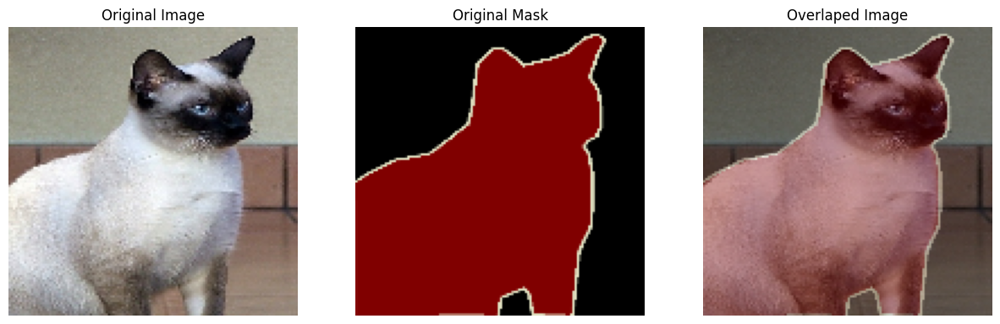

In [19]:
show_images(data=valid_ds, n_images=5, SIZE=(15,5))

In [20]:
class ConvBlock(Layer):

    def __init__(self, filters=256, kernel_size=3, dilation_rate=1, **kwargs):
        super(ConvBlock, self).__init__(**kwargs)

        self.filters = filters
        self.kernel_size = kernel_size
        self.dilation_rate = dilation_rate

        self.net = Sequential([
            Conv2D(filters, kernel_size=kernel_size, padding='same', dilation_rate=dilation_rate, use_bias=False, kernel_initializer='he_normal'),
            BatchNormalization(),
            ReLU()
        ])

    def call(self, X):
        return self.net(X)

    def get_config(self):
        base_config = super().get_config()
        return {
            **base_config,
            "filters":self.filters,
            "kernel_size":self.kernel_size,
            "dilation_rate":self.dilation_rate,
        }

In [21]:
def AtrousSpatialPyramidPooling(X):
    B, H, W, C = X.shape

    # Image Pooling
    image_pool = AveragePooling2D(pool_size=(H, W), name="ASPP-AvgPool")(X)
    image_pool = ConvBlock(kernel_size=1, name="ASPP-ImagePool-CB")(image_pool)
    image_pool = UpSampling2D(size=(H//image_pool.shape[1], W//image_pool.shape[2]), name="ASPP-ImagePool-UpSample")(image_pool)

    # Atrous Oprtations
    conv_1  = ConvBlock(kernel_size=1, dilation_rate=1, name="ASPP-CB-1")(X)
    conv_6  = ConvBlock(kernel_size=3, dilation_rate=6, name="ASPP-CB-6")(X)
    conv_12 = ConvBlock(kernel_size=3, dilation_rate=12, name="ASPP-CB-12")(X)
    conv_18 = ConvBlock(kernel_size=3, dilation_rate=18, name="ASPP-CB-18")(X)

    # Combine All
    combined = Concatenate(name="ASPP-Combine")([image_pool, conv_1, conv_6, conv_12, conv_18])
    processed = ConvBlock(kernel_size=1, name="ASPP-Net")(combined)

    # Final Output
    return processed

In [22]:
# PARAM
LR = 1e-3
IMAGE_SIZE = 128

# Input
InputL = Input(shape=(IMAGE_SIZE, IMAGE_SIZE, 3), name="InputLayer")

# Base Mode
resnet50 = ResNet50(include_top=False, weights='imagenet', input_tensor=InputL)

# ASPP Phase
DCNN = resnet50.get_layer('conv4_block6_2_relu').output
ASPP = AtrousSpatialPyramidPooling(DCNN)
ASPP = UpSampling2D(size=(IMAGE_SIZE//4//ASPP.shape[1], IMAGE_SIZE//4//ASPP.shape[2]), name="AtrousSpatial")(ASPP)

# LLF Phase
LLF = resnet50.get_layer('conv2_block3_2_relu').output
LLF = ConvBlock(filters=48, kernel_size=1, name="LLF-ConvBlock")(LLF)

# Combined
combined = Concatenate(axis=-1, name="Combine-LLF-ASPP")([ASPP, LLF])
features = ConvBlock(name="Top-ConvBlock-1")(combined)
features = ConvBlock(name="Top-ConvBlock-2")(features)
upsample = UpSampling2D(size=(IMAGE_SIZE//features.shape[1], IMAGE_SIZE//features.shape[1]), interpolation='bilinear', name="Top-UpSample")(features)

# Output Mask
PredMask = Conv2D(3, kernel_size=3, strides=1, padding='same', activation='sigmoid', use_bias=False, name="OutputMask")(upsample)

# DeelLabV3+ Model
model = Model(InputL, PredMask, name="DeepLabV3-Plus")
model.summary()

94765736/94765736 [==============================] - 0s 0us/step
Model: "DeepLabV3-Plus"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 InputLayer (InputLayer)     [(None, 128, 128, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 134, 134, 3)          0         ['InputLayer[0][0]']          
                                                                                                  
 conv1_conv (Conv2D)         (None, 64, 64, 64)           9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 64, 64, 64)           256       ['conv1_conv[0][0]']          
 on)                

In [23]:
# Callback
class ShowProgress(Callback):
    def on_epoch_end(self, epoch, logs=None):
        if (epoch+1)%5==0:
            show_images(valid_ds, model=self.model, explain=True, n_images=5, SIZE=(15,8))
# Callbacks
callbacks = [ModelCheckpoint("DeepLabV3-Plus.h5"), ShowProgress()]

Epoch 1/50
43/43 [==============================] - ETA: 0s - loss: 0.3115

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


43/43 [==============================] - 54s 931ms/step - loss: 0.3115 - val_loss: 1267.3188
Epoch 2/50
43/43 [==============================] - 38s 873ms/step - loss: 0.2795 - val_loss: 1758.1399
Epoch 3/50
43/43 [==============================] - 37s 861ms/step - loss: 0.2720 - val_loss: 0.3054
Epoch 4/50
43/43 [==============================] - 37s 865ms/step - loss: 0.2679 - val_loss: 0.3423
Epoch 5/50
1/1 [==============================] - 1s 1s/step


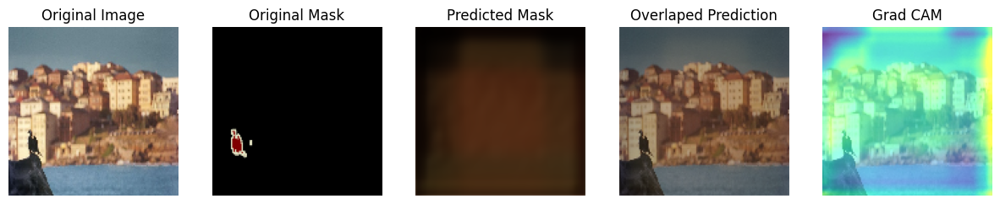

1/1 [==============================] - 0s 81ms/step


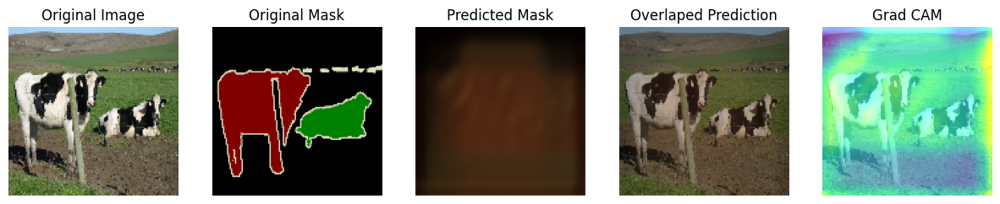

1/1 [==============================] - 0s 78ms/step


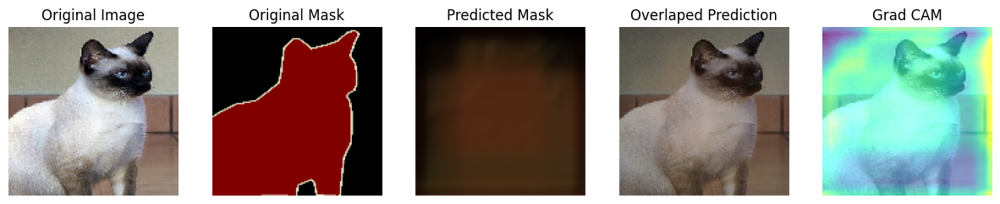

1/1 [==============================] - 0s 80ms/step


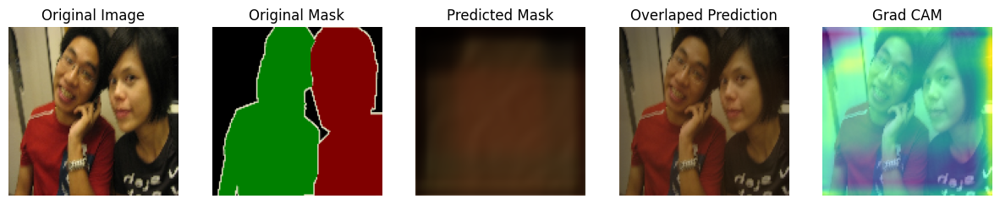

1/1 [==============================] - 0s 76ms/step


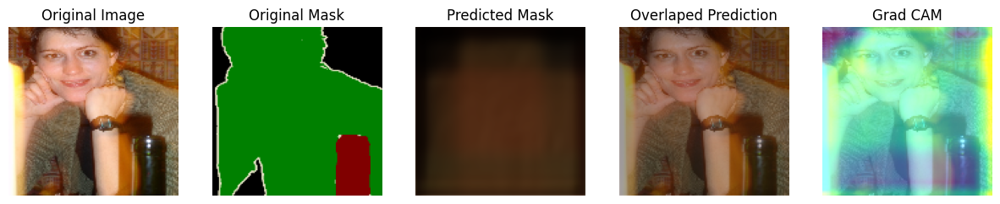

43/43 [==============================] - 44s 1s/step - loss: 0.2658 - val_loss: 0.3145
Epoch 6/50
43/43 [==============================] - 37s 861ms/step - loss: 0.2658 - val_loss: 0.3847
Epoch 7/50
43/43 [==============================] - 37s 864ms/step - loss: 0.2581 - val_loss: 0.5119
Epoch 8/50
43/43 [==============================] - 37s 862ms/step - loss: 0.2520 - val_loss: 0.5971
Epoch 9/50
43/43 [==============================] - 37s 854ms/step - loss: 0.2530 - val_loss: 0.3331
Epoch 10/50
1/1 [==============================] - 0s 69ms/step


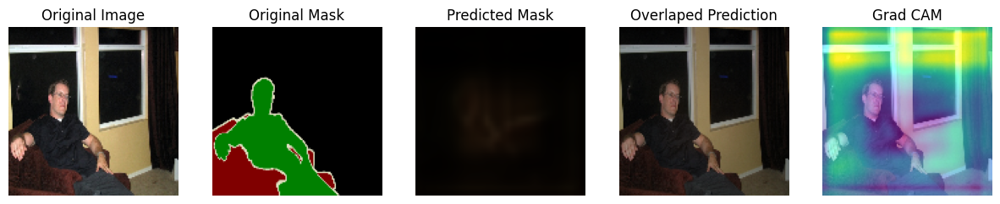

1/1 [==============================] - 0s 66ms/step


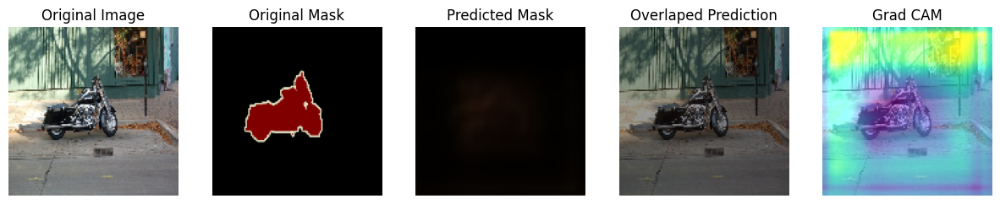

1/1 [==============================] - 0s 67ms/step


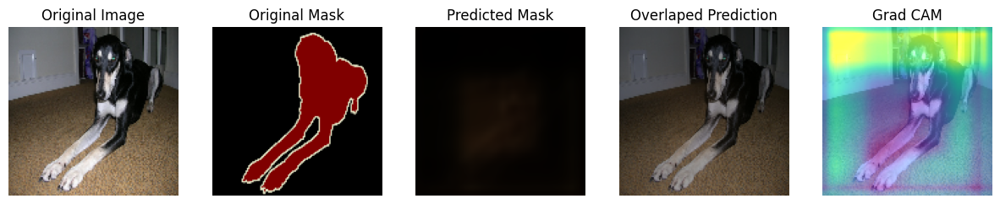

1/1 [==============================] - 0s 79ms/step


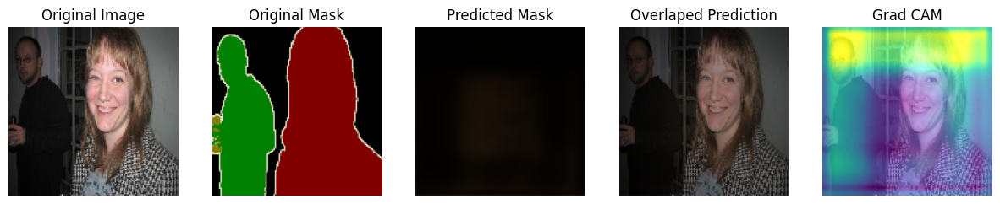

1/1 [==============================] - 0s 67ms/step


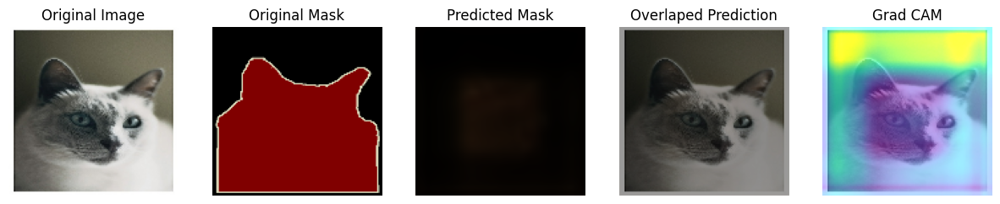

43/43 [==============================] - 42s 989ms/step - loss: 0.2498 - val_loss: 0.3986
Epoch 11/50
43/43 [==============================] - 37s 855ms/step - loss: 0.2469 - val_loss: 0.3459
Epoch 12/50
43/43 [==============================] - 37s 852ms/step - loss: 0.2386 - val_loss: 0.5128
Epoch 13/50
43/43 [==============================] - 37s 858ms/step - loss: 0.2277 - val_loss: 0.4988
Epoch 14/50
43/43 [==============================] - 37s 856ms/step - loss: 0.2207 - val_loss: 0.6452
Epoch 15/50
1/1 [==============================] - 0s 67ms/step


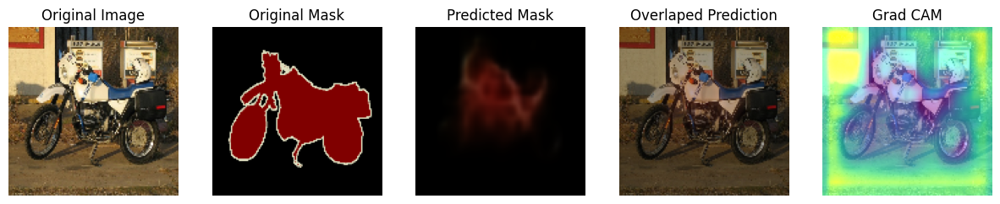

1/1 [==============================] - 0s 67ms/step


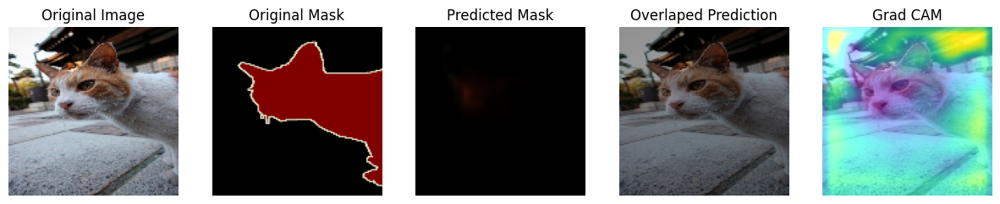

1/1 [==============================] - 0s 66ms/step


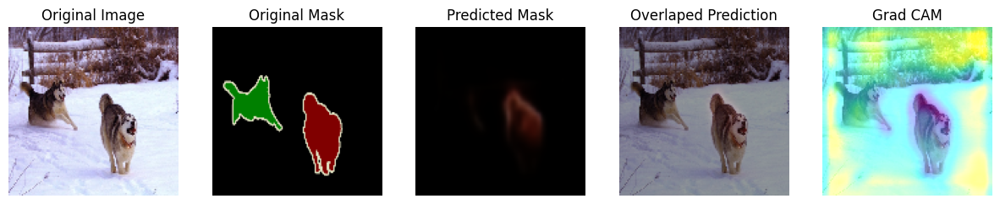

1/1 [==============================] - 0s 76ms/step


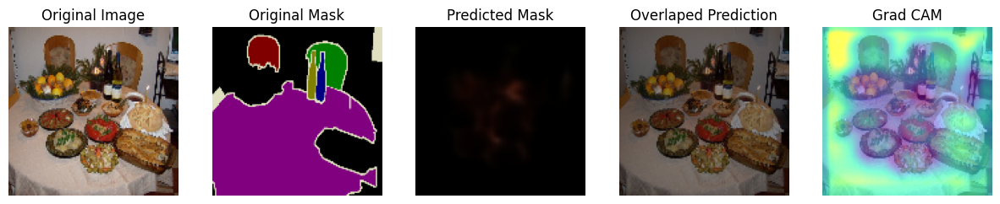

1/1 [==============================] - 0s 66ms/step


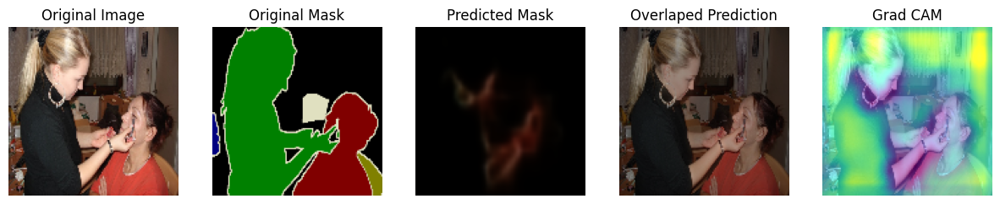

43/43 [==============================] - 42s 976ms/step - loss: 0.2133 - val_loss: 0.5567
Epoch 16/50
43/43 [==============================] - 37s 850ms/step - loss: 0.2077 - val_loss: 0.6072
Epoch 17/50
43/43 [==============================] - 37s 855ms/step - loss: 0.2034 - val_loss: 0.5464
Epoch 18/50
43/43 [==============================] - 37s 852ms/step - loss: 0.1974 - val_loss: 0.6041
Epoch 19/50
43/43 [==============================] - 37s 855ms/step - loss: 0.1917 - val_loss: 0.6272
Epoch 20/50
1/1 [==============================] - 0s 67ms/step


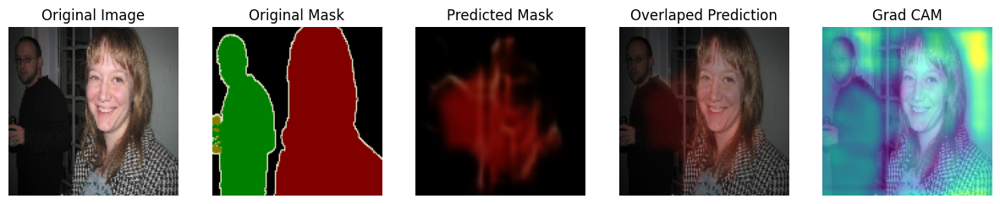

1/1 [==============================] - 0s 66ms/step


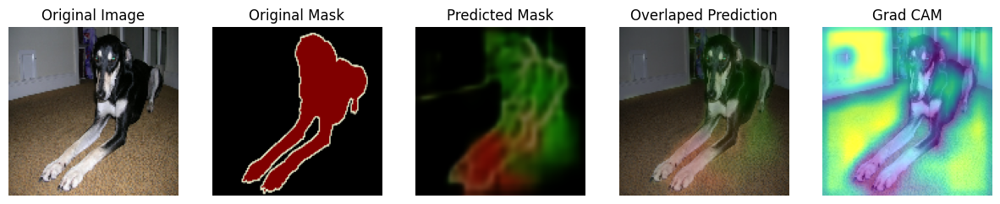

1/1 [==============================] - 0s 66ms/step


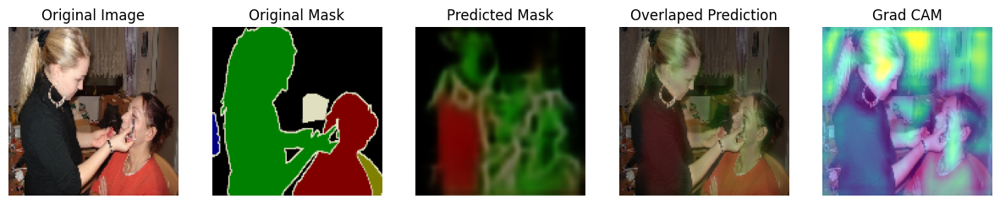

1/1 [==============================] - 0s 65ms/step


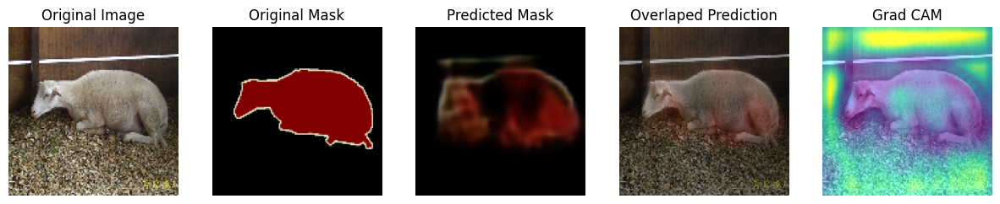

1/1 [==============================] - 0s 68ms/step


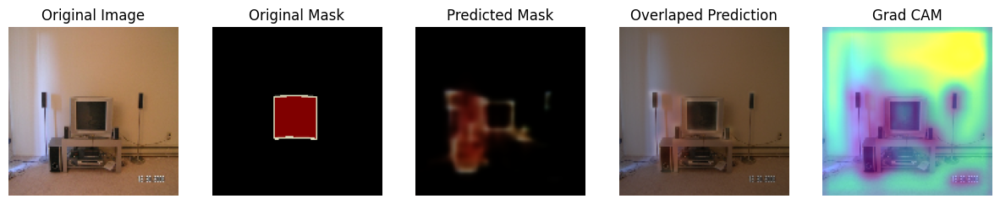

43/43 [==============================] - 42s 987ms/step - loss: 0.1882 - val_loss: 0.4149
Epoch 21/50
43/43 [==============================] - 37s 860ms/step - loss: 0.1830 - val_loss: 0.5082
Epoch 22/50
43/43 [==============================] - 37s 861ms/step - loss: 0.1766 - val_loss: 0.4490
Epoch 23/50
43/43 [==============================] - 37s 860ms/step - loss: 0.1748 - val_loss: 0.4807
Epoch 24/50
43/43 [==============================] - 37s 853ms/step - loss: 0.1707 - val_loss: 0.4169
Epoch 25/50
1/1 [==============================] - 0s 68ms/step


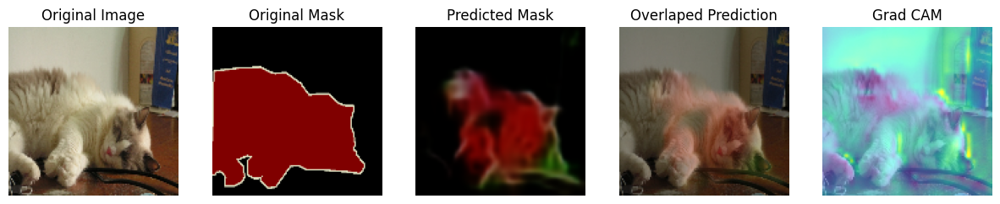

1/1 [==============================] - 0s 69ms/step


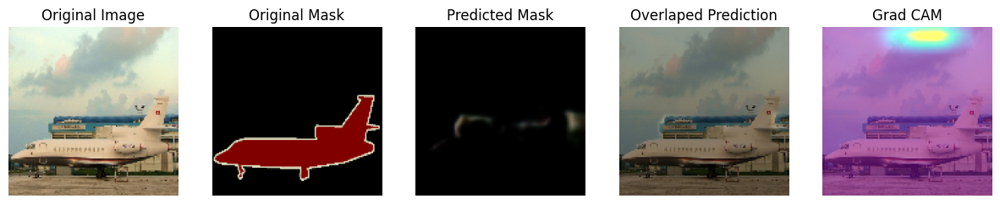

1/1 [==============================] - 0s 67ms/step


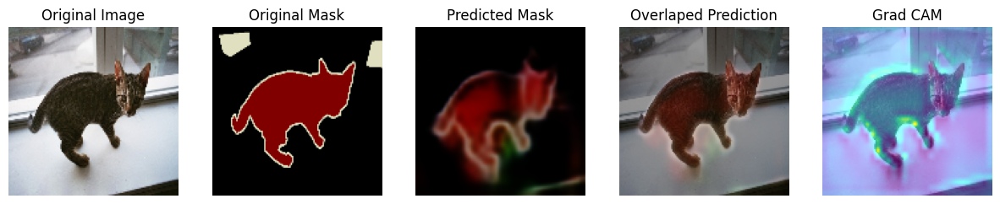

1/1 [==============================] - 0s 84ms/step


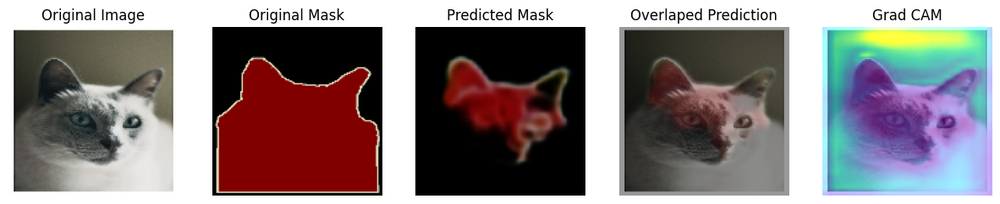

1/1 [==============================] - 0s 80ms/step


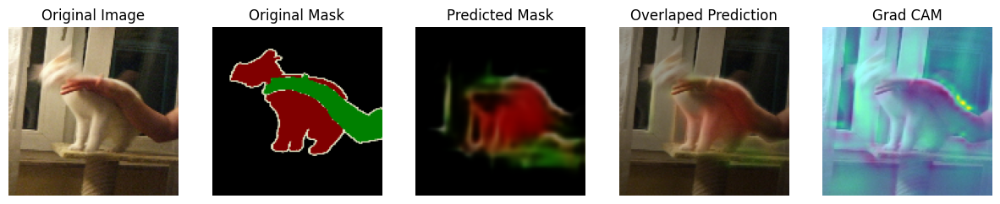

43/43 [==============================] - 42s 989ms/step - loss: 0.1658 - val_loss: 0.4611
Epoch 26/50
43/43 [==============================] - 37s 864ms/step - loss: 0.1619 - val_loss: 0.3845
Epoch 27/50
43/43 [==============================] - 37s 858ms/step - loss: 0.1585 - val_loss: 0.4450
Epoch 28/50
43/43 [==============================] - 37s 856ms/step - loss: 0.1548 - val_loss: 0.4087
Epoch 29/50
43/43 [==============================] - 37s 855ms/step - loss: 0.1530 - val_loss: 0.4275
Epoch 30/50
1/1 [==============================] - 0s 67ms/step


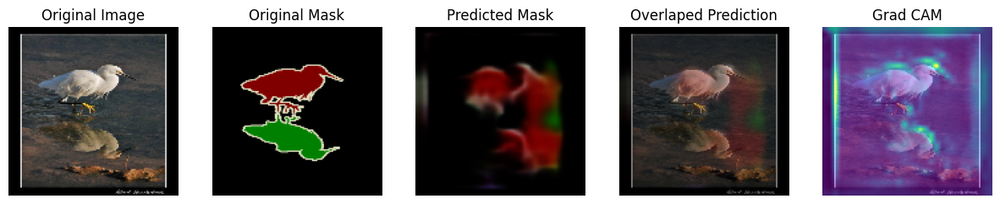

1/1 [==============================] - 0s 67ms/step


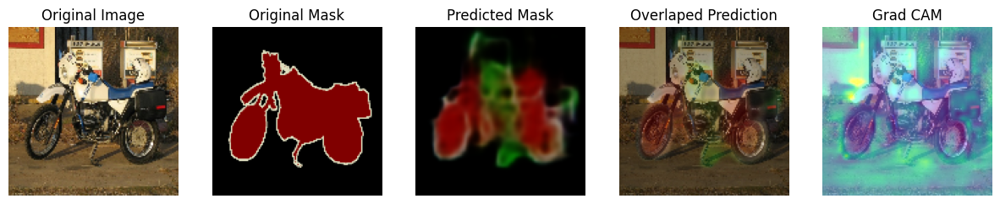

1/1 [==============================] - 0s 67ms/step


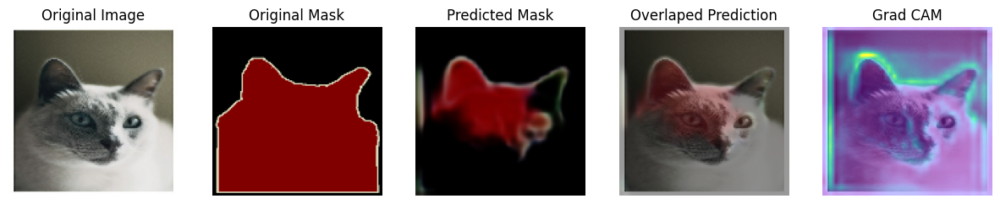

1/1 [==============================] - 0s 69ms/step


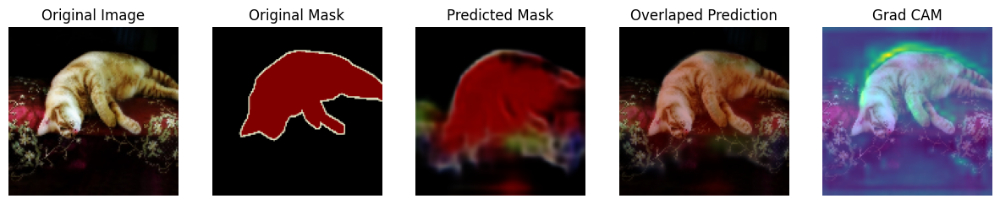

1/1 [==============================] - 0s 69ms/step


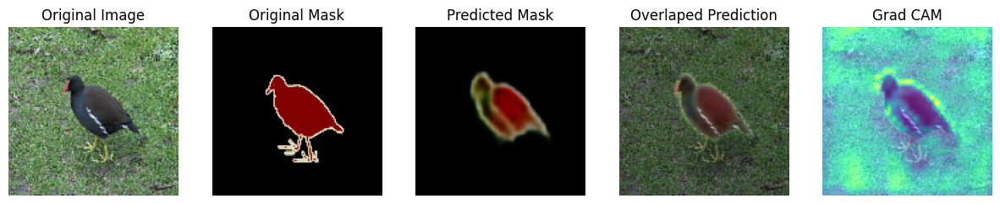

43/43 [==============================] - 42s 986ms/step - loss: 0.1501 - val_loss: 0.4259
Epoch 31/50
43/43 [==============================] - 37s 853ms/step - loss: 0.1479 - val_loss: 0.4306
Epoch 32/50
43/43 [==============================] - 37s 859ms/step - loss: 0.1457 - val_loss: 0.4526
Epoch 33/50
43/43 [==============================] - 37s 859ms/step - loss: 0.1448 - val_loss: 0.4998
Epoch 34/50
43/43 [==============================] - 37s 856ms/step - loss: 0.1450 - val_loss: 0.4875
Epoch 35/50
1/1 [==============================] - 0s 67ms/step


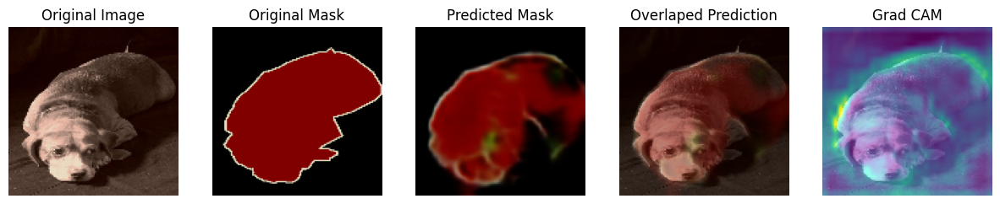

1/1 [==============================] - 0s 65ms/step


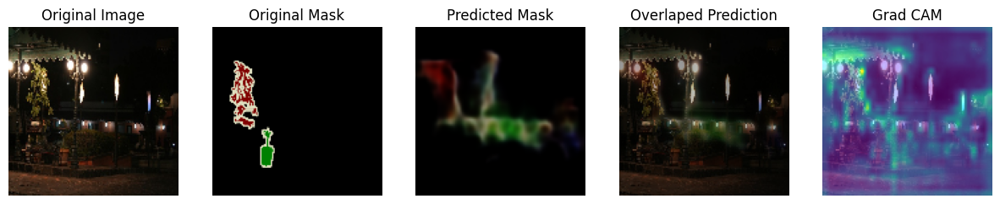

1/1 [==============================] - 0s 67ms/step


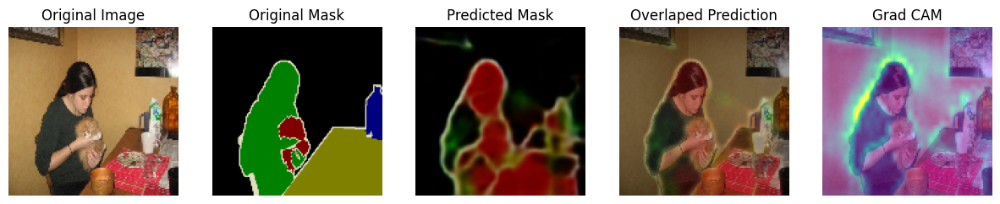

1/1 [==============================] - 0s 66ms/step


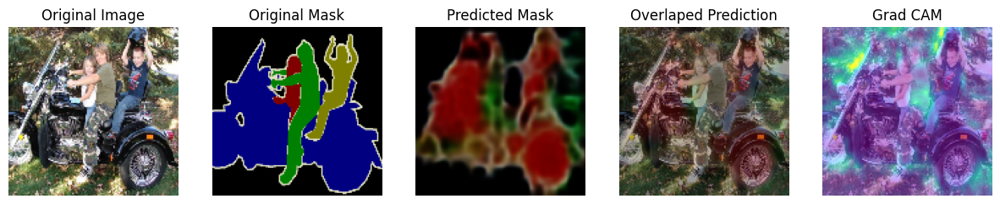

1/1 [==============================] - 0s 68ms/step


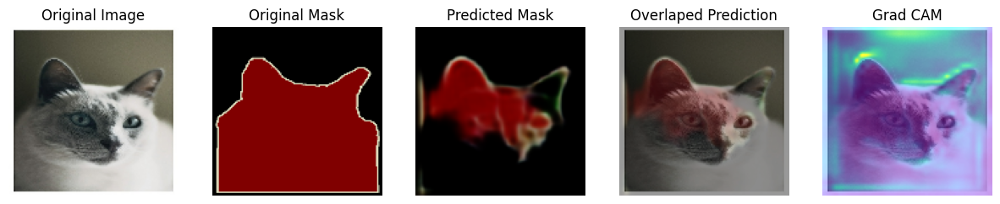

43/43 [==============================] - 42s 982ms/step - loss: 0.1433 - val_loss: 0.4658
Epoch 36/50
43/43 [==============================] - 37s 859ms/step - loss: 0.1412 - val_loss: 0.5169
Epoch 37/50
43/43 [==============================] - 37s 859ms/step - loss: 0.1398 - val_loss: 0.4629
Epoch 38/50
43/43 [==============================] - 37s 863ms/step - loss: 0.1380 - val_loss: 0.4961
Epoch 39/50
43/43 [==============================] - 37s 861ms/step - loss: 0.1364 - val_loss: 0.5131
Epoch 40/50
1/1 [==============================] - 0s 65ms/step


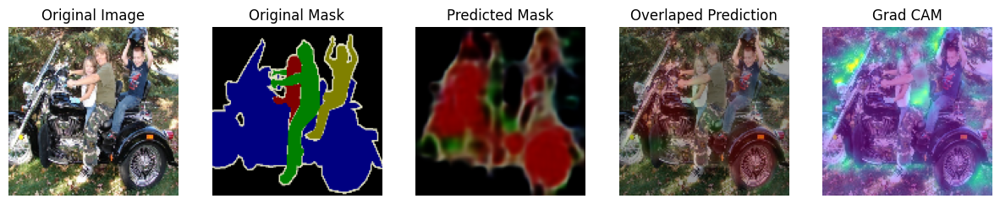

1/1 [==============================] - 0s 67ms/step


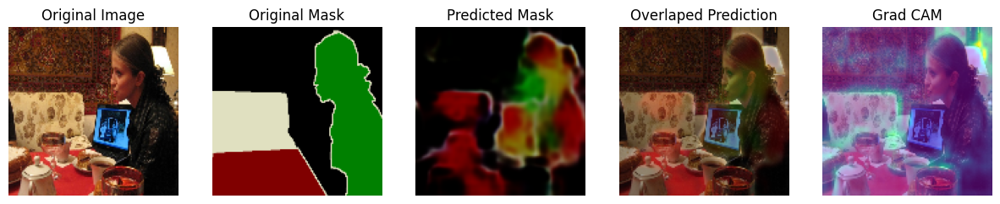

1/1 [==============================] - 0s 67ms/step


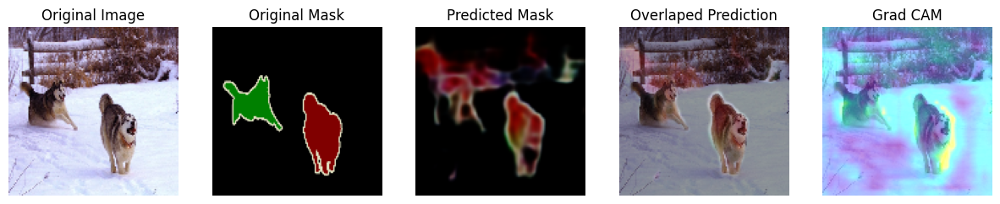

1/1 [==============================] - 0s 65ms/step


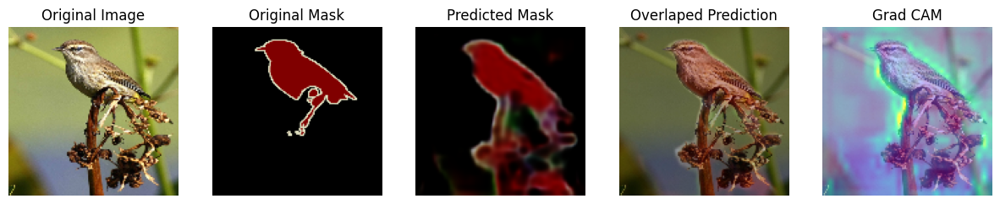

1/1 [==============================] - 0s 68ms/step


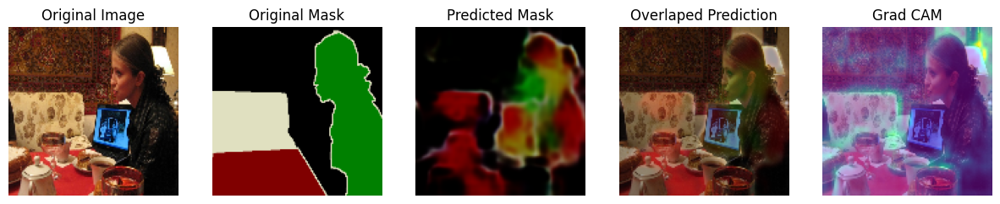

43/43 [==============================] - 42s 991ms/step - loss: 0.1352 - val_loss: 0.5165
Epoch 41/50
43/43 [==============================] - 37s 858ms/step - loss: 0.1349 - val_loss: 0.4971
Epoch 42/50
43/43 [==============================] - 37s 863ms/step - loss: 0.1346 - val_loss: 0.5352
Epoch 43/50
43/43 [==============================] - 37s 859ms/step - loss: 0.1338 - val_loss: 0.5775
Epoch 44/50
43/43 [==============================] - 37s 856ms/step - loss: 0.1330 - val_loss: 0.5520
Epoch 45/50
1/1 [==============================] - 0s 71ms/step


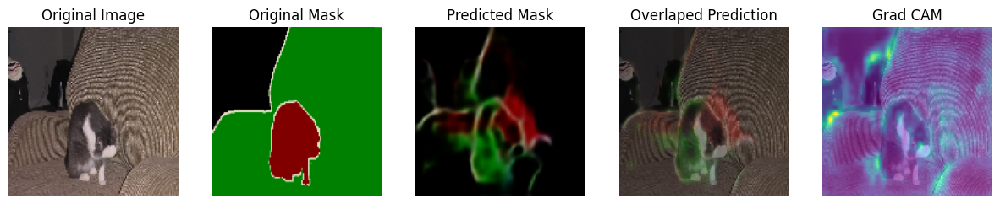

1/1 [==============================] - 0s 66ms/step


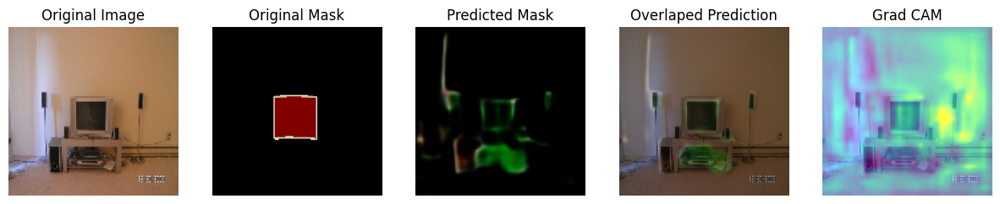

1/1 [==============================] - 0s 69ms/step


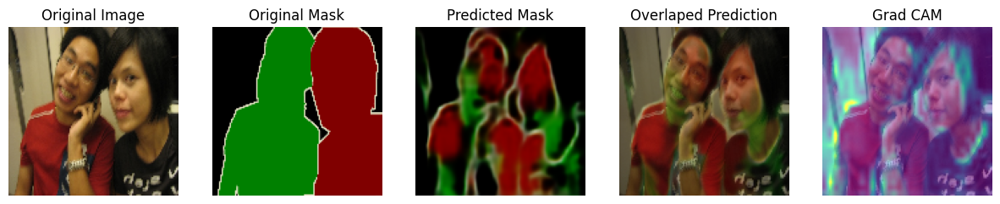

1/1 [==============================] - 0s 68ms/step


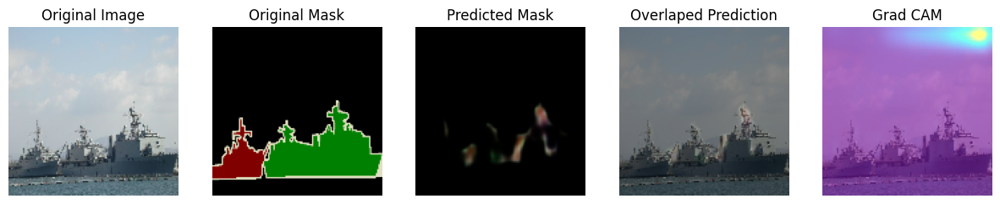

1/1 [==============================] - 0s 69ms/step


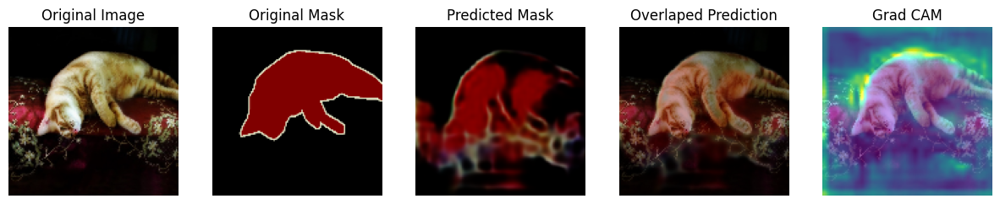

43/43 [==============================] - 42s 981ms/step - loss: 0.1319 - val_loss: 0.5995
Epoch 46/50
43/43 [==============================] - 37s 861ms/step - loss: 0.1312 - val_loss: 0.6040
Epoch 47/50
43/43 [==============================] - 37s 851ms/step - loss: 0.1301 - val_loss: 0.6101
Epoch 48/50
43/43 [==============================] - 37s 858ms/step - loss: 0.1296 - val_loss: 0.5974
Epoch 49/50
43/43 [==============================] - 37s 850ms/step - loss: 0.1299 - val_loss: 0.6153
Epoch 50/50
1/1 [==============================] - 0s 66ms/step


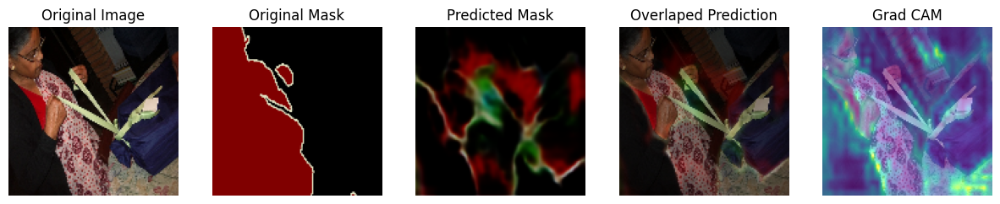

1/1 [==============================] - 0s 68ms/step


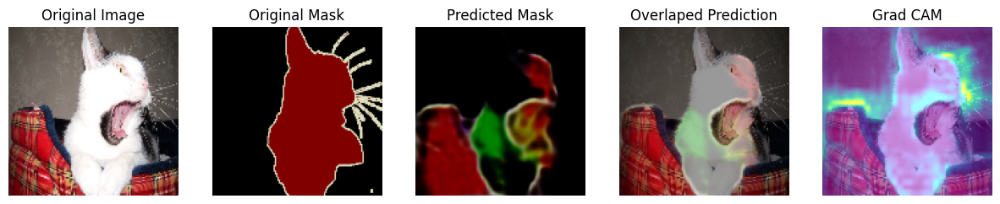

1/1 [==============================] - 0s 65ms/step


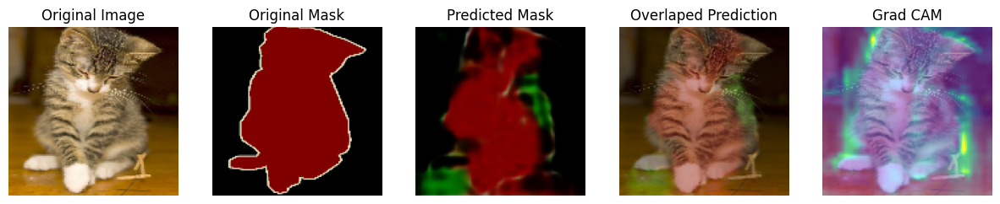

1/1 [==============================] - 0s 67ms/step


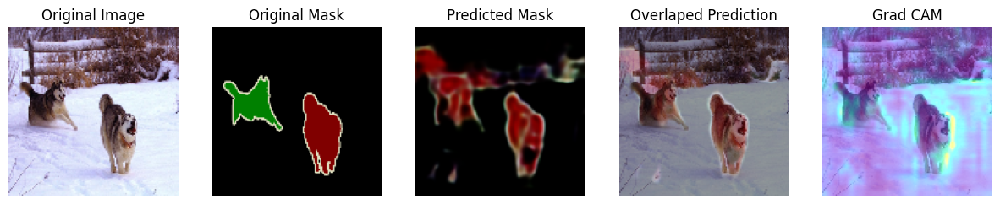

1/1 [==============================] - 0s 84ms/step


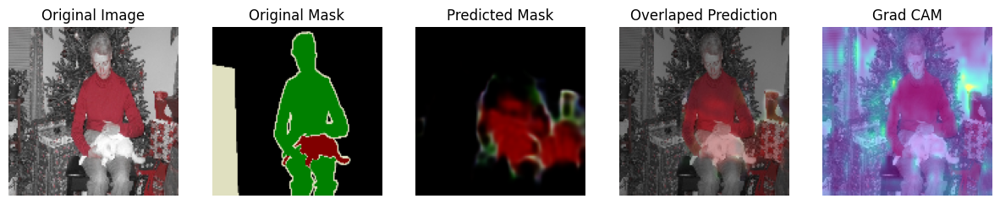

43/43 [==============================] - 43s 998ms/step - loss: 0.1292 - val_loss: 0.6065


In [24]:

optimizer = tf.keras.optimizers.Adam(learning_rate=LR)
model.compile(loss='binary_crossentropy', optimizer=optimizer)
model.fit(train_ds, validation_data=valid_ds, epochs=50, callbacks=callbacks)






# Training

